Importiamo le librerie:

In [495]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn import preprocessing

Carichiamo il dataset:

In [496]:
DATASET_PATH = 'datasets/csgo_round_snapshots.csv'

In [497]:
df = pd.read_csv(DATASET_PATH)

In [498]:
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


# Preprocessing

In [499]:
# Controlliamo se ci sono valori nulli
df.isnull().sum()

time_left                    0
ct_score                     0
t_score                      0
map                          0
bomb_planted                 0
                            ..
ct_grenade_molotovgrenade    0
t_grenade_molotovgrenade     0
ct_grenade_decoygrenade      0
t_grenade_decoygrenade       0
round_winner                 0
Length: 97, dtype: int64

In [500]:
# Controlliamo se ci sono duplicati
df.duplicated().sum()

np.int64(4962)

Abbiamo trovato 0 valori nulli e 4962 duplicati. 
Il dataset é composto anche da snapshot durante i periodi di time out, quindi i duplicati sono dovuti a questo. 
Dal momento che snapshot duplicati non ci danno informazioni aggiuntive, possiamo eliminarli.

In [501]:
df.drop_duplicates(inplace=True)

In [502]:
# Identifica le colonne con un solo valore univoco
unique_counts = df.nunique()

# Trova gli indici delle colonne con un solo valore univoco
constant_columns = unique_counts[unique_counts == 1].index

# Stampa gli indici delle colonne costanti
print("Colonne con un solo valore univoco:", constant_columns.tolist())

Colonne con un solo valore univoco: ['ct_weapon_bizon', 'ct_weapon_g3sg1', 't_weapon_m249', 'ct_weapon_negev', 'ct_weapon_r8revolver', 'ct_weapon_sawedoff']


<Axes: xlabel='ct_weapon_bizon', ylabel='count'>

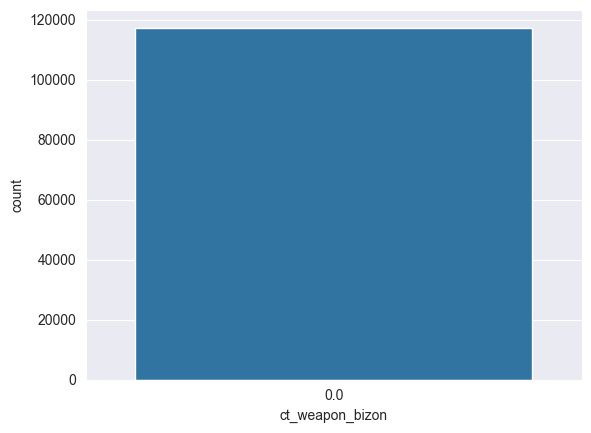

In [503]:
sns.countplot(x='ct_weapon_bizon', data=df)

Essendo armi che non vengono utilizzate, possiamo eliminarle.

In [504]:
df.drop(columns=constant_columns, inplace=True)
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


In [505]:
# Controlliamo se ci sono abbastanza dati per ogni mappa
map_counts = df['map'].value_counts()

# Visualizza il conteggio
print("Numero di dati per ogni mappa:")
print(map_counts)


Numero di dati per ogni mappa:
map
de_inferno     22982
de_dust2       21252
de_nuke        18078
de_mirage      17793
de_overpass    13474
de_train       12919
de_vertigo     10805
de_cache         145
Name: count, dtype: int64


Dal momento che de_cache ha un numero di dati insufficiente rispetto alle altre mappe, é meglio eliminarla dal dataset.

In [506]:
df = df[df['map'] != 'de_cache']

# Conferma la rimozione
print("Distribuzione aggiornata delle mappe:")
print(df['map'].value_counts())

Distribuzione aggiornata delle mappe:
map
de_inferno     22982
de_dust2       21252
de_nuke        18078
de_mirage      17793
de_overpass    13474
de_train       12919
de_vertigo     10805
Name: count, dtype: int64


Infine, sul dataset abbiamo degli errori noti, come la presenza di valori maggiori di 5 per le variabili 't_weapon_cz75auto', 't_weapon_glock' e 'ct_weapon_usps', quando il numero massimo di armi per giocatore é, appunto, 5. Eliminiamo quindi le righe con questi errori.

In [507]:
df.drop(df[(df['t_weapon_cz75auto'] > 5) | (df['t_weapon_glock'] > 5) | (df['ct_weapon_usps'] > 5)].index, inplace=True)
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


## Variabili categoriche

In [508]:
print(df['map'].isnull().sum())

0


In [509]:
# Crea un LabelEncoder separato per ogni variabile categorica
map_encoder = preprocessing.OneHotEncoder(sparse_output=False)
bomb_encoder = preprocessing.LabelEncoder()
winner_encoder = preprocessing.LabelEncoder()

# One-Hot Encoding
map_encoded = map_encoder.fit_transform(df[['map']])
# Converti in DataFrame con i nomi delle colonne basati sulle categorie
map_encoded_df = pd.DataFrame(map_encoded, columns=map_encoder.get_feature_names_out(['map']))

# Reimpostiamo gli indici dopo aver rimosso le righe
df.reset_index(drop=True, inplace=True)
# Aggiungi le colonne One-Hot al DataFrame originale
df = pd.concat([df, map_encoded_df], axis=1)
# Ora 'map' è stata sostituita da colonne One-Hot quindi possiamo rimuovere la colonna originale
df.drop('map', axis=1, inplace=True)

df['bomb_planted'] = bomb_encoder.fit_transform(df['bomb_planted'])
df['round_winner'] = winner_encoder.fit_transform(df['round_winner'])

df.head()

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner,map_de_dust2,map_de_inferno,map_de_mirage,map_de_nuke,map_de_overpass,map_de_train,map_de_vertigo
0,175.00,0.0,0.0,0,500.0,500.0,0.0,0.0,4000.0,4000.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,156.03,0.0,0.0,0,500.0,500.0,400.0,300.0,600.0,650.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,96.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,76.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,174.97,1.0,0.0,0,500.0,500.0,192.0,0.0,18350.0,10750.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [510]:
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117281 entries, 0 to 117280
Data columns (total 97 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   time_left                     117281 non-null  float64
 1   ct_score                      117281 non-null  float64
 2   t_score                       117281 non-null  float64
 3   bomb_planted                  117281 non-null  int64  
 4   ct_health                     117281 non-null  float64
 5   t_health                      117281 non-null  float64
 6   ct_armor                      117281 non-null  float64
 7   t_armor                       117281 non-null  float64
 8   ct_money                      117281 non-null  float64
 9   t_money                       117281 non-null  float64
 10  ct_helmets                    117281 non-null  float64
 11  t_helmets                     117281 non-null  float64
 12  ct_defuse_kits                117281 non-nul

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner,map_de_dust2,map_de_inferno,map_de_mirage,map_de_nuke,map_de_overpass,map_de_train,map_de_vertigo
count,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,...,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000
mean,94.641399,6.768743,6.829981,0.116583,408.507678,398.659587,317.759023,302.611693,9990.912424,11493.404729,...,0.027703,0.025136,0.510611,0.181155,0.195923,0.151661,0.154117,0.114886,0.110146,0.092112
std,53.222675,4.802416,4.833263,0.320924,133.854735,141.381686,170.321526,174.101162,11295.513293,12239.095163,...,0.169689,0.162316,0.499890,0.385148,0.396911,0.358694,0.361062,0.318886,0.313073,0.289185
min,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,54.910000,3.000000,3.000000,0.000000,335.000000,309.000000,195.000000,179.000000,1300.000000,1650.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,94.890000,6.000000,6.000000,0.000000,500.000000,500.000000,382.000000,353.000000,5900.000000,7650.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,114.960000,10.000000,11.000000,0.000000,500.000000,500.000000,487.000000,471.000000,15000.000000,18350.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,175.000000,32.000000,33.000000,1.000000,500.000000,500.000000,500.000000,500.000000,80000.000000,80000.000000,...,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


Ora il dataset é pronto per l'analisi.

# Analisi Esplorativa

Vediamo innanzitutto la distribuzione delle mappe giocate dai giocatori professionisti.

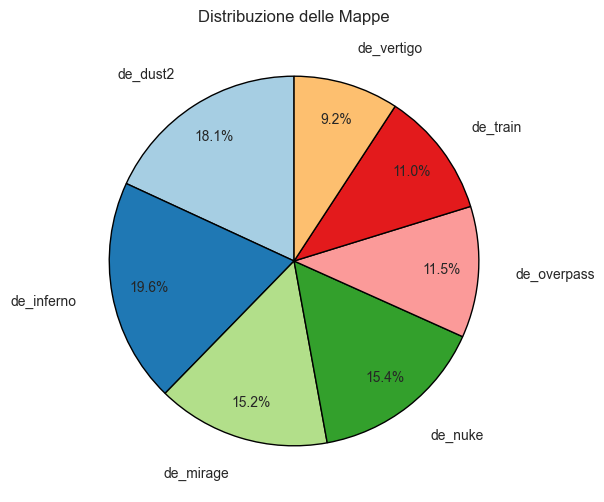

In [511]:
# Ottieni le colonne One-Hot delle mappe
map_columns = [col for col in df.columns if col.startswith('map_')]

# Calcolare le occorrenze di ciascuna mappa
map_counts = df[map_columns].sum()

# Rinominare le mappe rimuovendo il prefisso "map_"
map_counts.index = map_counts.index.str.replace('map_', '')

# Creare il grafico a torta
plt.figure(figsize=(12, 6))
map_counts.plot.pie(
    autopct='%1.1f%%',
    startangle=90,
    colors=plt.cm.Paired.colors,
    labeldistance=1.2,
    wedgeprops={'edgecolor': 'black'},
    pctdistance=0.8
)
plt.title('Distribuzione delle Mappe')
plt.ylabel('')  # Toglie il label y
plt.show()

La mappa più giocata é de_inferno (19.6%), seguita da de_dust2 (18.1%) e de_nuke (15.4%).
La mappa meno giocata é de_vertigo (9.2%).

Analizziamo la situazione dei round vinti dai Terroristi e dai Contro-Terroristi in de_inferno.

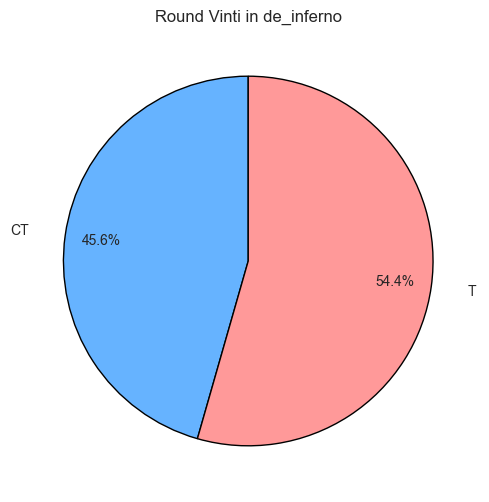

In [512]:
# Definisci i colori per CT e T
color_ct = '#66b3ff'
color_t = '#ff9999'

# Filtra i dati per la mappa 'de_inferno'
inferno_df = df[df['map_de_inferno'] == 1]

# Calcola la distribuzione di round_winner
round_winner_counts = inferno_df['round_winner'].value_counts().sort_index()  # Ordina per 0 e 1

# Disegna il grafico a torta
plt.figure(figsize=(6, 6))
round_winner_counts.plot.pie(
    autopct='%1.1f%%',  # Percentuali per ciascuna fetta
    startangle=90,  # Imposta l'angolo di inizio
    colors=[color_ct, color_t],  # Colori per CT (0) e T (1)
    labels=['CT', 'T'],  # Etichette manuali: CT per 0 e T per 1
    labeldistance=1.2,  # Distanza tra l'etichetta e il centro
    wedgeprops={'edgecolor': 'black'},  # Bordo alle fette
    pctdistance=0.8  # Posizione delle percentuali
)
plt.title('Round Vinti in de_inferno')  # Titolo del grafico
plt.ylabel('')  # Rimuove il label sull'asse Y
plt.show()  # Mostra il grafico

Pare che su de_inferno i Terroristi abbiano un leggero vantaggio rispetto ai Contro-Terroristi.

Vediamo ora come l'economia influisce sui round vinti.

In [520]:
# 1. Calcola il numero di round vinti dalla squadra con il maggior numero di soldi
rounds_won_by_max_money_team = pd.concat([
    df[(df['ct_money'] > df['t_money']) & (df['round_winner'] == 0)],  # CT ha più soldi e vince
    df[(df['t_money'] > df['ct_money']) & (df['round_winner'] == 1)]   # T ha più soldi e vince
])

# 2. Calcola il numero di round persi dalla squadra con il maggior numero di soldi
rounds_lost_by_max_money_team = pd.concat([
    df[(df['ct_money'] > df['t_money']) & (df['round_winner'] == 1)],  # CT ha più soldi e perde
    df[(df['t_money'] > df['ct_money']) & (df['round_winner'] == 0)]   # T ha più soldi e perde
])

# 3. Calcola la percentuale di round vinti
total_rounds = len(df)
rounds_won = len(rounds_won_by_max_money_team)
percent_rounds_won = (rounds_won / total_rounds) * 100

# 4. Calcola la percentuale di round persi
rounds_lost = len(rounds_lost_by_max_money_team)
percent_rounds_lost = (rounds_lost / total_rounds) * 100

# Mostra i risultati
print(f"Percentuale di round vinti dalla squadra con il maggior numero di soldi: {percent_rounds_won:.1f}%")
print(f"Percentuale di round persi dalla squadra con il maggior numero di soldi: {percent_rounds_lost:.1f}%")

Percentuale di round vinti dalla squadra con il maggior numero di soldi: 60.2%
Percentuale di round persi dalla squadra con il maggior numero di soldi: 38.1%


Quindi, la squadra con piú soldi vince tendenzialmente piú round rispetto a quella con meno soldi.

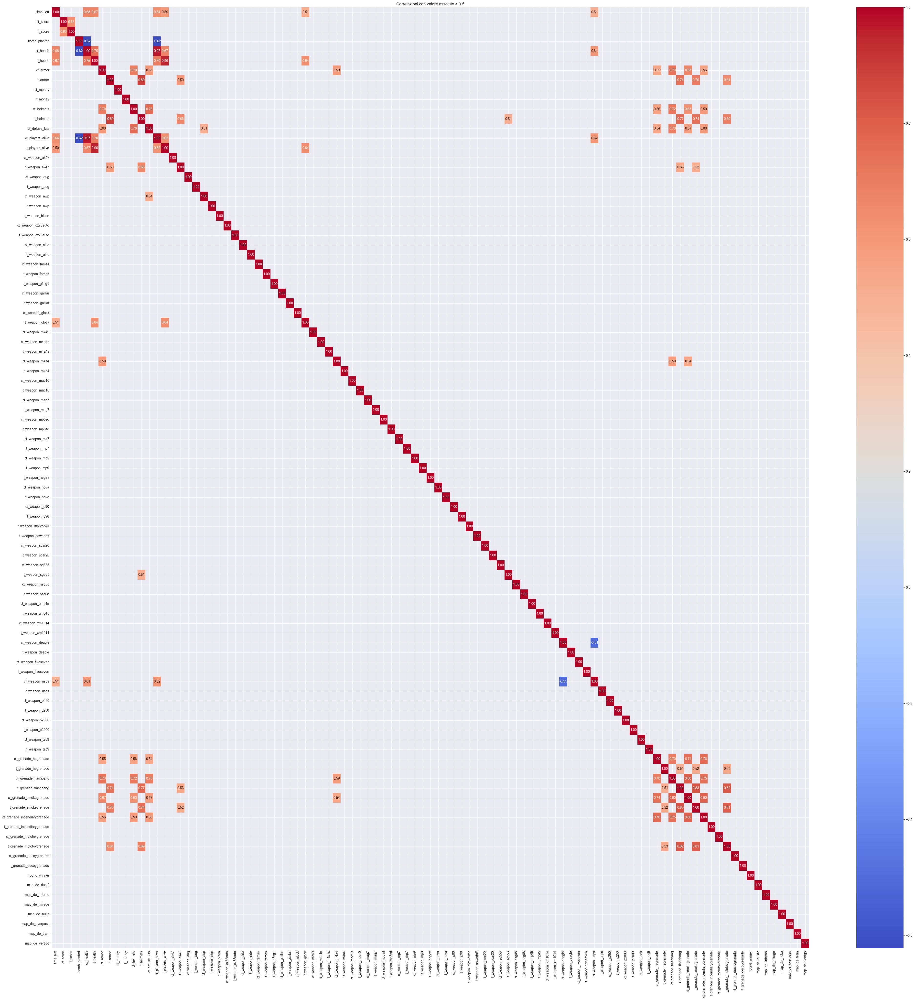

In [514]:
# Calcolare la matrice di correlazione
correlation_matrix = df.corr()

# Filtrare le correlazioni con valore assoluto superiore a 0.5
high_corr = correlation_matrix[correlation_matrix.abs() > 0.5]

# Creiamo una heatmap per visualizzare solo le correlazioni forti
plt.figure(figsize=(50, 50))
sns.heatmap(high_corr, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlazioni con valore assoluto > 0.5")
plt.show()

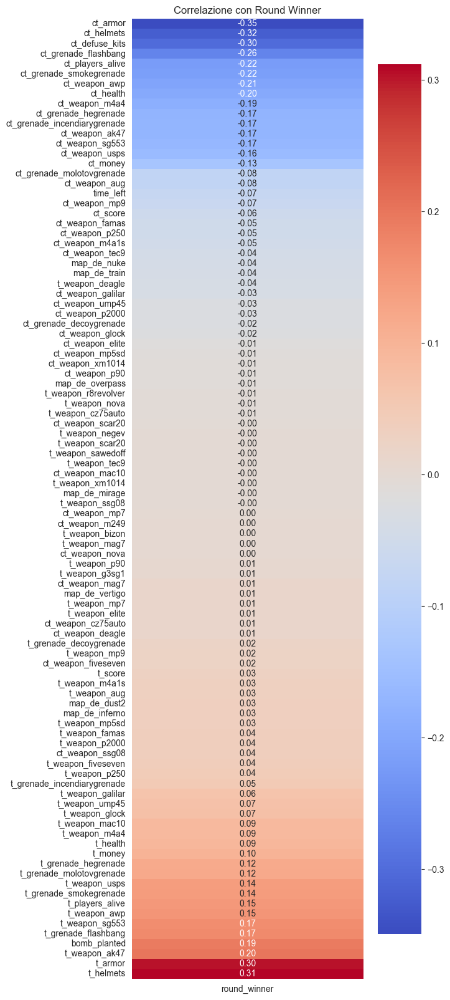

In [515]:
# Calcola le correlazioni tra 'round_winner' e tutte le altre colonne numeriche
correlation = df.corr()  # Calcola la matrice di correlazione
round_winner_corr = correlation['round_winner'].drop('round_winner')# Prendi solo la colonna 'round_winner' e rimuovi se stessa

# Ordina i valori in ordine crescente
round_winner_corr_sorted = round_winner_corr.sort_values()

plt.figure(figsize=(6, 20))
sns.heatmap(
    round_winner_corr_sorted.to_frame(),  # Converti in dataframe
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    cbar=True
)
plt.title("Correlazione con Round Winner")
plt.show()

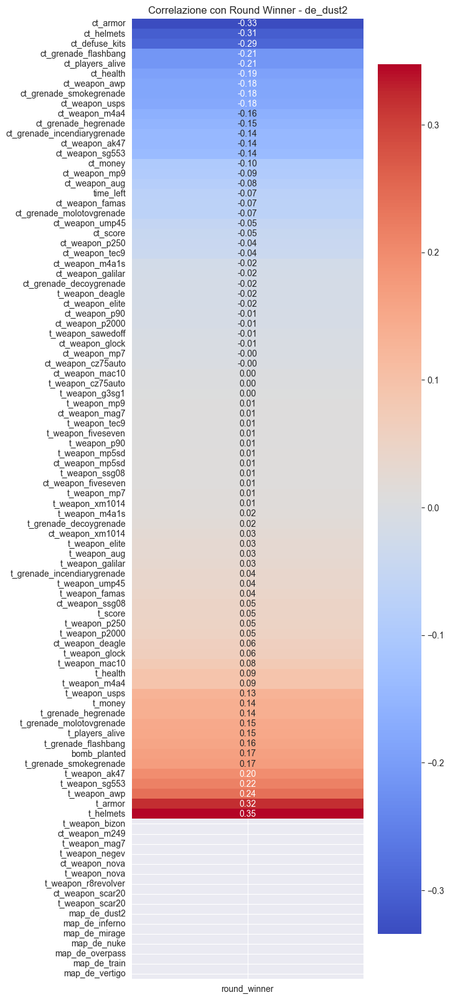

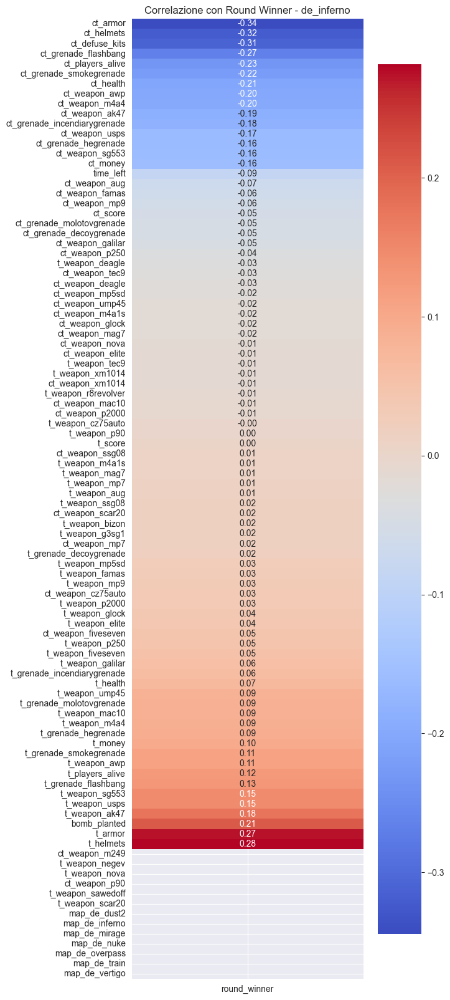

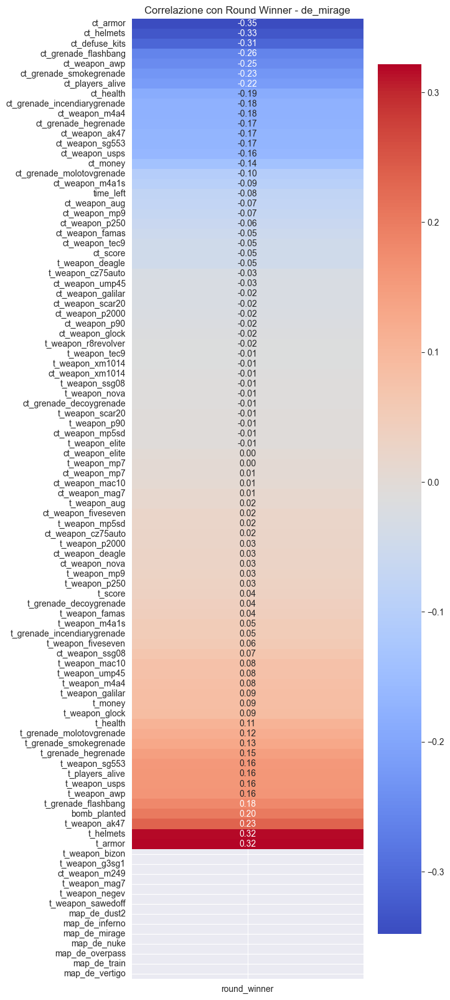

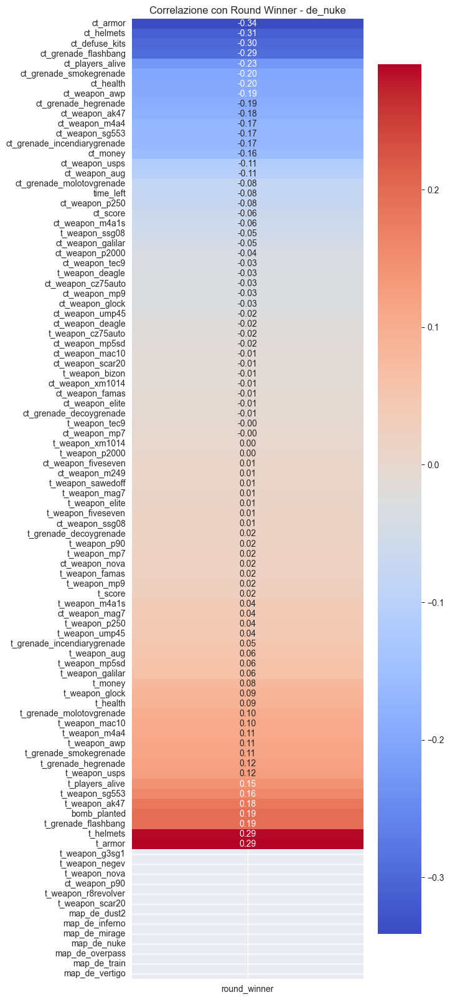

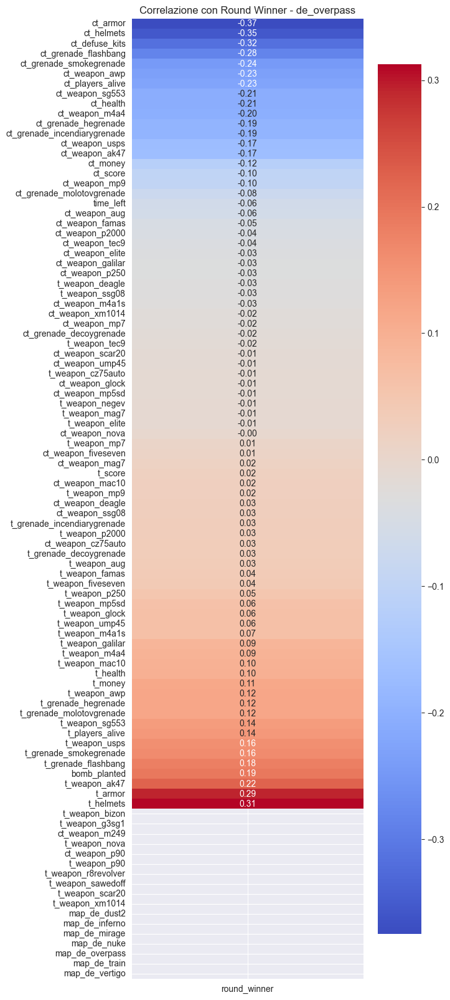

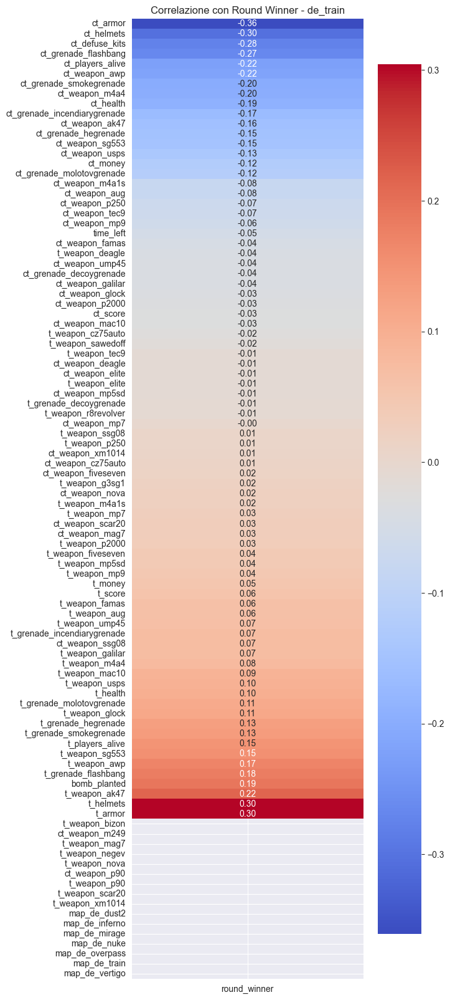

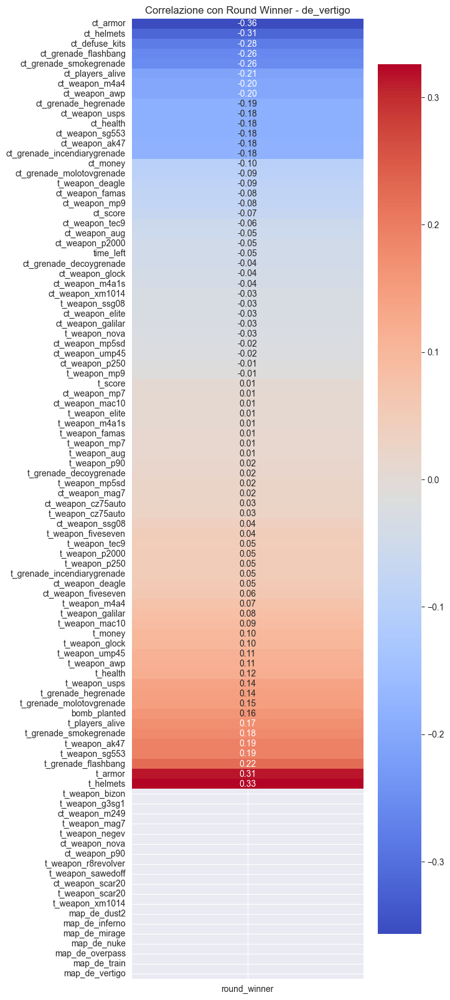

In [516]:
# Ottieni le colonne One-Hot delle mappe
map_columns = [col for col in df.columns if col.startswith('map_')]

# Itera su ogni colonna One-Hot e calcola le correlazioni
for map_col in map_columns:
    # Filtra il dataset per la mappa corrente (dove la colonna della mappa è 1)
    df_map = df[df[map_col] == 1]
    
    if len(df_map) > 1:  # Assicurati che ci siano abbastanza dati
        # Calcola la matrice di correlazione per questa mappa
        correlation = df_map.corr()
        
        # Prendi solo la colonna 'round_winner'
        round_winner_corr = correlation['round_winner'].drop('round_winner').sort_values()
        
        # Plotta la heatmap
        plt.figure(figsize=(6, 20))
        sns.heatmap(
            round_winner_corr.to_frame(),
            annot=True,
            fmt=".2f",
            cmap="coolwarm",
            cbar=True
        )
        
        # Usa il nome originale della colonna come titolo
        plt.title(f"Correlazione con Round Winner - {map_col.replace('map_', '')}")
        plt.show()
    else:
        print(f"Pochi dati per la mappa: {map_col.replace('map_', '')}")

In [517]:
fig = px.histogram(df,"time_left")
fig.show()

fig = px.histogram(df,"ct_score")
fig.show()

fig = px.histogram(df,"t_score")
fig.show()

fig = px.histogram(df,"ct_health")
fig.show()

fig = px.histogram(df,"t_health")
fig.show()

fig = px.histogram(df,"ct_armor")
fig.show()

fig = px.histogram(df,"ct_money")
fig.show()

fig = px.histogram(df,"t_grenade_flashbang")
fig.show()

fig = px.histogram(df,"ct_grenade_smokegrenade")
fig.show()

fig = px.histogram(df,"ct_weapon_usps")
fig.show()